<hr/>
<b>Nombre</b>: Sebastian Yepes Acevedo
<br/>


## Enunciado

**Objetivo**: El objetivo de esta tarea es poner a prueba la idea de que es posible simular un  sistema de N-cuerpos jerarquicos usando un *árbol* de sistemas de 2 cuerpos.

En particular compararemos la predicción de las posiciones que para un sistema múltiple de estrellas nos da la simulación con un sistema jerárquico y el mismo resultado pero calculado como si el sistema fuera un sistema de N cuerpos completo.

**Procedimiento**:

El sistema que simularemos es el de un sistema binario formado por dos estrellas "s" y "e".  Alrededor de la estrella "e" gira un planeta "p", a cuyo alrededor, a su vez, gira una luna "L".  Los datos de los cuerpos, dados en unidades canónicas, en las que $U_M = 80$ M$_{\rm Jup}$, $U_L = 0.01$ au, son.

- Masas: s = 1, e = 0.5, L = 0.001, p = 0.01.

- Condiciones iniciales: a continuación se proveen datos del vector y velocidad relativa para cada subsistema:

   - Sistema p-L: $\vec r :(0.03,0,0), \vec v : (0,0.4,0.1)$

   - Sistema e-pL (baricentro de p y L): $\vec r :(0,0.4,0), \vec v : (0.9,0,0.2)$
     
  - Sistema s-epL (baricentro e y pL): $\vec r :(2,3,0), \vec v : (-0.2,0.7,0)$



Una vez definidas las condiciones iniciales:

1. Dibujar el árbol del sistema jerárquico como lo hicimos en clase, indicando claramente el nombre de las variables que requiere para la construcción del sistema (vectores relativos, posiciones del centro de masa, etc.)

2. Simular usando `doscuerpos_solucion` cada subsistema por separado y obtener el vector y la velocidad relativa como función del tiempo para cada subsistema. Para el tiempo total de simulación encuentre el período orbital de cada subsistema. Determine esos períodos mediante la experimentación o con alguna estrategia numérica. Explique su método y estrategia claramente. El tiempo de la simulación de todo el sistema será igual al período más largo entre todos los subsistemas.

3. Suponiendo que el centro de masa de todo el sistema está en reposo en el origen, calcular a partir de la solución al problema relativo de cada subsistema, la posición de cada cuerpo en el tiempo.

4. Haga gráficos de las posiciones y una animación que muestre la trayectoria de las partículas.

5. Tomando las posiciones iniciales calculadas en 3, use la rutina  `ncuerpos_solucion` para encontrar las posiciones y velocidades de todas las partículas respecto del centro de masa. Haga un gráfico de la solución obtenida y compare con el obtenido en 4. ¿Se ven parecidas?

6. Haga gráficos de las componentes x, y, z de la posición de cada partícula del sistema a lo largo del tiempo, calculadas con la aproximación jerárquica (punto 3) y con la solución al sistema completo (punto 5). Un gráfico por cuerpo. Comente su resultado.

7. Haga gráficos de la energía cinética total, la energía potencial total y la energía mecánica total como función del tiempo usando los resultados en 3. El gráfico debe expresarse en unidades convencionales: en el eje x el tiempo en días, en el eje y la energía en Joules. ¿Qué observa?

**Resultados esperados**:

- Este notebook con el procedimiento debidamente comentado.

- Gráficos mínimos:
  - Gráficos solicitados en cada punto.

- Datos mínimos:
  - Números solicitados en cada punto.

- Gráficos opcionales:
  - Animación mostrando el movimiento de una de las partículas, predicho con la aproximación jerarquica y con la integración precisa.

  - Gráfico de la energía cinética, potencial y total para la simulación de N-cuerpos (punto 5).

- En caso de utilizar ayudas como `ChatGPT` o códigos de `Stack Over Flow` debe citar debidamente la fuente, pero también entender a cabalidad el código, el profesor puede pedir justificación.

## Solución

In [ ]:
!pip install -Uq pymcel

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 910.2/910.2 kB 18.8 MB/s eta 0:00:00


In [ ]:
import pymcel as pc
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

Paquete pymcel cargado. Versión: 0.5.10


# Punto 1

Construimos el arbol que describe el sistema que se analizará en el siguiente trabajo.

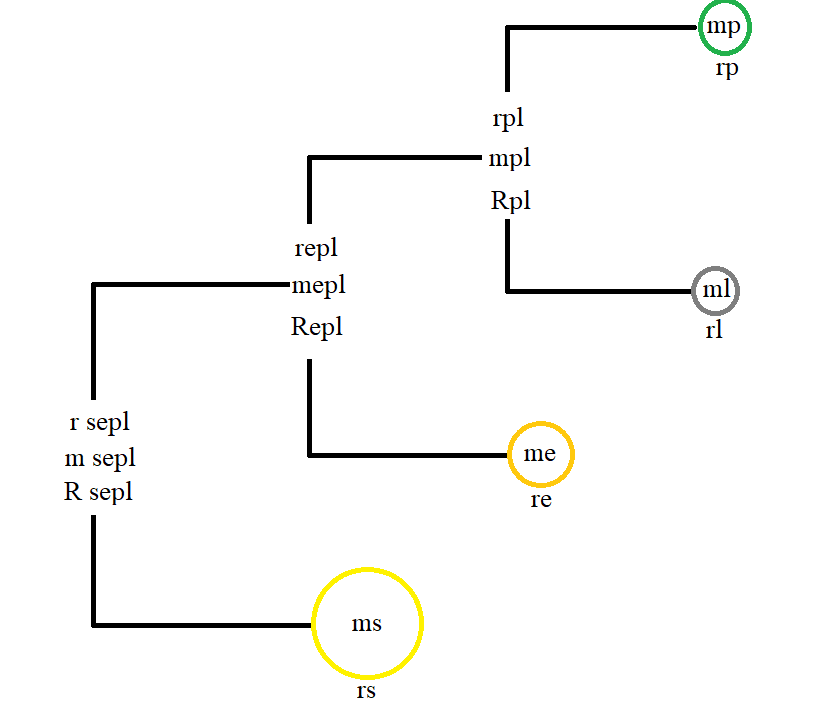

Donde la letra $m$ representa la masa del cuerpo, $r$ siendo la posición del cuerpo o el subsistema y $R$ como la posición del centro de masa.

# Punto 2

Se realiza una simulación usando en método de *doscuerpos_solucion* partiendo desde la cantidad de masa y las condiciones iniciales, se conforman subsistemas para la simulación.

In [ ]:
#Definimos las masas de cada cuerpo que conforman el sistema
m_s = 1
m_e = 0.5
m_p = 0.01
m_l = 0.001

#Encontramos las masas de los subsistemas
m_pl = m_p + m_l
m_epl =  m_e + m_p + m_l
m_sepl = m_s + m_e + m_p + m_l


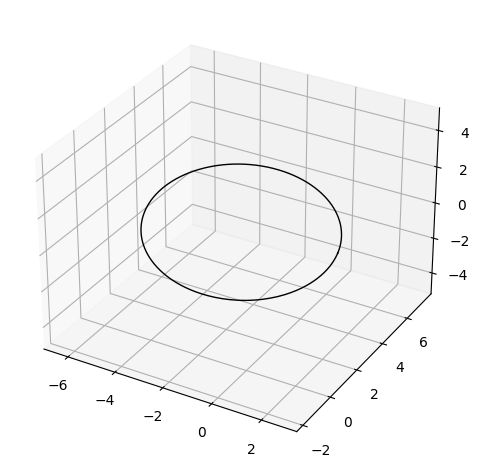

In [ ]:
#Generamos los subsistemas

ts = np.linspace(0,55.5,500) #Definimos el tiempo de la simulación
r_sepl = [2, 3, 0]
v_sepl = [-0.2, 0.7, 0]

rs_sepl, vs_sepl = pc.doscuerpos_solucion(m_sepl,r_sepl,v_sepl,ts) #Realizamos la simulación

fig = pc.plot_doscuerpos_3d(rs_sepl, vs_sepl) #se grafica la orbita


Se repite el proceso anterior para encontrar los demás subsistemas

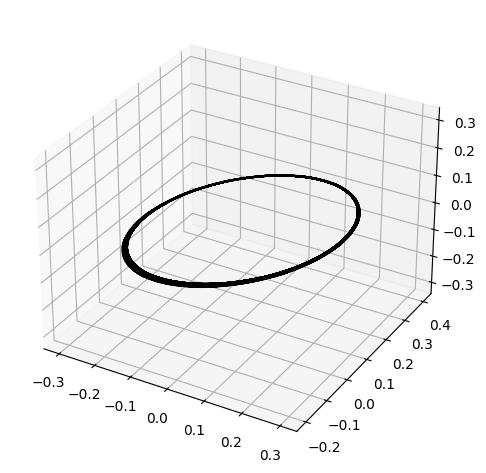

In [ ]:
r_epl = [0, 0.4, 0]
v_epl = [0.9, 0, 0.2]

rs_epl, vs_epl = pc.doscuerpos_solucion(m_epl,r_epl,v_epl,ts)
fig = pc.plot_doscuerpos_3d(rs_epl, vs_epl)

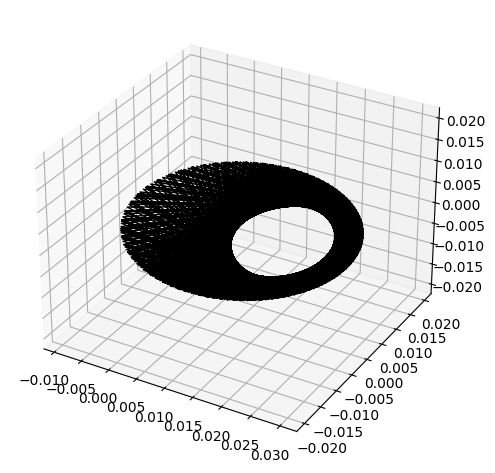

In [ ]:
r_pl = [0.03, 0, 0]
v_pl = [0, 0.4, 0.1]

rs_pl, vs_pl = pc.doscuerpos_solucion(m_pl,r_pl,v_pl,ts)
fig = pc.plot_doscuerpos_3d(rs_pl, vs_pl)

Para el calculo del periodo orbital, se proponen valores para cada subsistema con el fin de encontrar el punto donde la orbita se cierra o el que más se aceque a este fin. De esta forma comenzamos el análisis al primer sistema.

Para el sistema ESPL, se comienza usando el valor de $30 U_T$, para lo cual se presenta una orbita incompleta, para lo cual se procede a usar un valor de $50 U_T$, lo que logra presentar más de la mitad del recorrido para la orbita, lo que indica que nos estamos acercando.
Finalmente al usarse un valor de $55U_T$, conseguimos que la  orbita casi se complete, dejando un espacio mínimo entre las lineas dle gráfico, por lo cual se decide usar $55 U_T$, logrando así un aproximado al periodo de este subsistema.

Ahora bien, para el segundo sistema SPL, notamos que al mantener los valores usados para el anterior, se completa más de una orbita, por lo cual comenzaremos con usar un valor de $20U_T$, con lo cual se nota que se completan aún más giros de lo que necesitamos para conocer su periodo, por lo cual usamos un valor aún más bajo, siendo en este caso $1U_T$, obteniendo así más de la mitad del giro, lo que indica que nos estamos acercando. Finalmente al usar el valor de $1.45U_T$ obtemos un valor que logra completar el giro y acercarse a lo que se espararía que fuese el periodo para este sistemas.

Finalmente, para analizar el último sistema, teniendo en cuenta los resultados de los anteriores experimentos, comenzaremos un valor de $0.1U_T$ que nos devuelve una orbita completa hasta un poco más de la mitad, luego usaremos el valor $0.15U_T$, con lo que obtenemos una orbita casi completa, indicando que nos falta sólo un poco para encontrar su periodo aproximado, por ello usaremos el valor de $0.165U_T$ que finalmente nos da un periodo aproximado para este último sistema.

Con el fin de comprobar qué tan cercano fue nuestro resultado, usaremos el siguiente método:

Partiendo de la propiedad de la *vis viva* tenemos el valor del semieje mayor:

$$a=\frac{\mu}{\frac{2\mu}{r}-v^2}$$

Luego, usando la ecuación (29) propuesta en el libro de [Mecánica Celeste](https://astronomia-udea.co/MecanicaCeleste-Zuluaga/html/07.02.00.00.Problema2Cuerpos.ProblemaRelativo.html#teorema_arm%C3%B3nico) del profesor Jorge Zuluaga, donde se deduce la siguiente ecuación que es la forma original de la ley armónica de Kepler:

$$\frac{a^3}{T^2}=\frac{\mu}{4\pi^2}$$

Donde al despejar $T$, obtenemos:

$$T=2\pi\mu\sqrt{\frac{r^3}{(2\mu-v^2r)^3}}$$

Usando la ecuación anterior procederemos a calcular el periodo de cada sistema y así comparar ambos resultados obtenidos.

In [ ]:
#Los valores que utilizaremos, son los que conocemos desde el principio
def periodo(mu,ri,vi):
  r = np.linalg.norm(ri)
  v = np.linalg.norm(vi)
  T_PL = (2 * np.pi * mu ) * ((r**3)/((2*mu)-(v**2*r))**3) ** 0.5
  return T_PL

T_sepl = periodo(m_sepl, r_sepl, v_sepl)
T_epl = periodo(m_epl,r_epl,v_epl)
T_pl = periodo(m_pl,r_pl,v_pl)

P1 = [T_sepl, T_epl, T_pl ]
pd.DataFrame(P1,columns = ["Periodos"])


,Periodos
0,55.500495
1,1.442162
2,0.163465


Con ello logramos encontrar el periodo más largo siendo de $55.500495 U_T$, lo cual usaremos como tiempo total de nuestra simulación de ahora en adelante

# Punto 3

A partir de la solución anterior, supondremos que el centro de masa de todo el sistema está en reposo y en el origen, armaremos el sistema encontrando cada cuerpo por separado, de la siguiente manera:

In [ ]:
RCM_sepl = np.zeros_like(rs_sepl) #Definimos el centro de masa en el origen y en reposo
VCM_sepl = np.zeros_like(rs_sepl)

rs_s = RCM_sepl + (m_epl/m_sepl)*rs_sepl #Realizamos el calculo para la posición y velocidad de la estrella S junto con el sistema epl
vs_s = VCM_sepl + (m_epl/m_sepl)*vs_sepl

RCM_epl = RCM_sepl - (m_s/m_sepl)*rs_sepl
VCM_epl = VCM_sepl - (m_s/m_sepl)*vs_sepl  #Calculamos el centro de masa del sistema epl a partir del sepl

rs_e = RCM_epl + (m_pl/m_epl)*rs_epl
vs_e = VCM_epl + (m_pl/m_epl)*vs_epl #Calculamos la posicion y velocidad de la estrella e junto con el sistema pl

RCM_pl = RCM_epl - (m_e/m_epl)*rs_epl
VCM_pl = VCM_epl - (m_e/m_epl)*vs_epl #Calculamos el centro de masa del sistema pl a partir de epl

rs_p = RCM_pl + (m_l/m_pl)*rs_pl
vs_p = VCM_pl + (m_l/m_pl)*vs_pl   #Finalmente calculamos los ultimos cuerpos que nos hacen falta

rs_l = RCM_pl - (m_p/m_pl)*rs_pl
vs_l = VCM_pl - (m_p/m_pl)*vs_pl

In [ ]:
#Usamos dataframes para mostrar los dator obtenidos por la simulación
#Datos Estrella s
pd.DataFrame(list(zip(rs_s[:,0], rs_s[:,1], rs_s[:,2], vs_s[:,0], vs_s[:,1], vs_s[:,2])), columns = ["X","Y","Z","Vx","Vy","Vz"])

,X,Y,Z,Vx,Vy,Vz
0,0.676373,1.014560,0.0,-0.067637,0.236731,0.0
1,0.668718,1.040689,0.0,-0.069997,0.233125,0.0
2,0.660807,1.066420,0.0,-0.072233,0.229583,0.0
3,0.652655,1.091760,0.0,-0.074350,0.226104,0.0
4,0.644273,1.116718,0.0,-0.076358,0.222686,0.0
...,...,...,...,...,...,...
495,0.704162,0.905809,0.0,-0.056767,0.251818,0.0
496,0.697682,0.933601,0.0,-0.059713,0.247952,0.0
497,0.690885,0.960967,0.0,-0.062499,0.244151,0.0
498,0.683785,0.987914,0.0,-0.065134,0.240416,0.0


In [ ]:
#Datos Estrella e
pd.DataFrame(list(zip(rs_e[:,0], rs_e[:,1], rs_e[:,2], vs_e[:,0], vs_e[:,1], vs_e[:,2])), columns = ["X","Y","Z","Vx","Vy","Vz"])

,X,Y,Z,Vx,Vy,Vz
0,-1.323627,-1.976830,0.000000,0.151736,-0.463269,0.004305
1,-1.306527,-2.028387,0.000471,0.155382,-0.463859,0.004089
2,-1.289151,-2.080016,0.000892,0.156635,-0.464534,0.003395
3,-1.271797,-2.131714,0.001203,0.154820,-0.465019,0.002071
4,-1.254876,-2.183411,0.001318,0.148565,-0.464191,-0.000192
...,...,...,...,...,...,...
495,-1.373550,-1.766200,0.000990,0.125075,-0.510080,0.003108
496,-1.359666,-1.822913,0.001258,0.123906,-0.509595,0.001567
497,-1.346174,-1.879489,0.001300,0.117694,-0.507153,-0.001025
498,-1.333731,-1.935465,0.000978,0.105093,-0.497359,-0.004971


In [ ]:
#Datos Planeta P
pd.DataFrame(list(zip(rs_p[:,0], rs_p[:,1], rs_p[:,2], vs_p[:,0], vs_p[:,1], vs_p[:,2])), columns = ["X","Y","Z","Vx","Vy","Vz"])

,X,Y,Z,Vx,Vy,Vz
0,-1.320899,-2.376830,0.000000,-0.748264,-0.426906,-0.186604
1,-1.403839,-2.410080,-0.021765,-0.634851,-0.103556,-0.184587
2,-1.474968,-2.399632,-0.040188,-0.627043,0.233765,-0.156893
3,-1.520574,-2.354606,-0.054620,-0.285630,0.618382,-0.085134
4,-1.528901,-2.275181,-0.060259,0.243706,0.870833,0.012572
...,...,...,...,...,...,...
495,-1.578353,-2.065442,-0.045269,-0.490139,0.321811,-0.134052
496,-1.623487,-2.013085,-0.057174,-0.208537,0.501974,-0.101310
497,-1.615693,-1.928325,-0.058844,0.298524,0.886130,0.053930
498,-1.535742,-1.835481,-0.044655,1.170613,0.783308,0.233996


In [ ]:
#Datos Satélite L
pd.DataFrame(list(zip(rs_l[:,0], rs_l[:,1], rs_l[:,2], vs_l[:,0], vs_l[:,1], vs_l[:,2])), columns = ["X","Y","Z","Vx","Vy","Vz"])

,X,Y,Z,Vx,Vy,Vz
0,-1.350899,-2.376830,0.000000,-0.748264,-0.826906,-0.286604
1,-1.416196,-2.394167,-0.017787,-1.345165,-0.159909,-0.198676
2,-1.482188,-2.415396,-0.044129,0.185646,0.346200,-0.128784
3,-1.550297,-2.357293,-0.055292,-0.203124,0.222104,-0.184203
4,-1.545689,-2.260052,-0.056477,-0.361557,0.701490,-0.029764
...,...,...,...,...,...,...
495,-1.602786,-2.054265,-0.042475,-0.869485,0.004248,-0.213443
496,-1.614447,-2.013619,-0.057308,-0.154511,1.826028,0.229703
497,-1.640426,-1.939246,-0.061575,0.666933,0.563669,-0.026685
498,-1.562435,-1.826581,-0.042430,0.881519,0.430179,0.145714


# Punto 4

Para apreciar mucho mejor los resultados, realizamos una gráfica del sistema, junto con una animación que permita apreciar el movimiento de las particulas

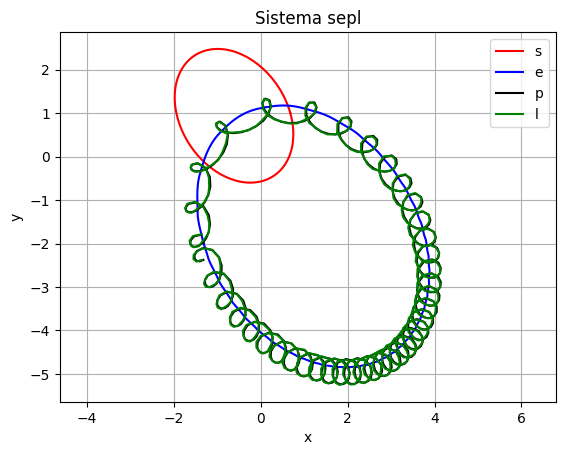

In [ ]:
#Grafico del sistema sepl
plt.plot(rs_s[:,0], rs_s[:,1],'r-', label = 's')
plt.plot(rs_e[:,0], rs_e[:,1],'b-', label = 'e')
plt.plot(rs_p[:,0], rs_p[:,1],'k-', label = 'p')
plt.plot(rs_l[:,0], rs_l[:,1],'g-', label = 'l')

plt.xlabel('x')
plt.ylabel('y')
plt.title('Sistema sepl')
plt.axis('equal')
plt.legend()
plt.grid()

In [ ]:
#Instalamos el paquete necesario para la animación del sistema anterior
!pip install -Uq celluloid

In [ ]:
from celluloid import Camera

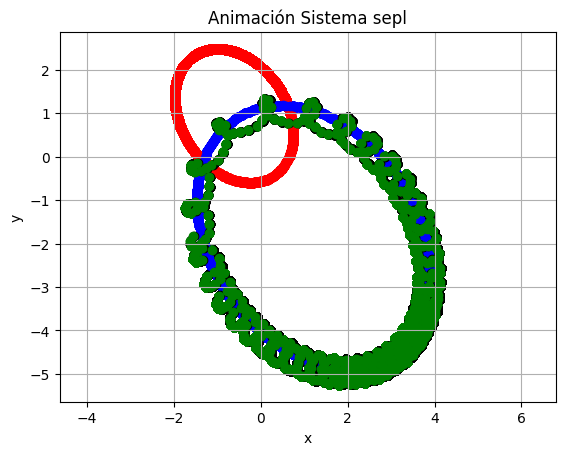

In [ ]:
fig = plt.figure()
camara = Camera(fig)
plt.title('Animación Sistema sepl')
plt.xlabel('x')
plt.ylabel('y')
plt.grid()
plt.axis('equal')
for i in range(len(ts)): #Realizamos un ciclo para tomar cada paso de las particulas

  plt.scatter(rs_s[:i,0], rs_s[:i,1],c = 'r',label = 's')
  plt.scatter(rs_e[:i,0], rs_e[:i,1],c = 'b',label = 'e')
  plt.scatter(rs_p[:i,0], rs_p[:i,1],c = 'k',label = 'p')
  plt.scatter(rs_l[:i,0], rs_l[:i,1],c = 'g',label = 'l')
  camara.snap()


In [ ]:
animacion = camara.animate()
from IPython.display import HTML
HTML(animacion.to_jshtml())

Cabe resaltar el comportamiento del planeta y el satélite, dado a la mínima diferencia en cuanto a masas y la cercanía en la que están uno del otro, parecen orbitar la estrella e de forma casi simultanea.

# Punto 5

Con el fin de comprobar que el método entrega un sistema correcto, compararemos la solución obtenida con el método de ncuerpos solución.

In [ ]:
rs = np.zeros((4,len(ts),3)) #Generamos arreglos para ordenar las posiciones y velocidades en diccionarios
vs = np.zeros((4,len(ts),3))

rs[0] = rs_s
rs[1] = rs_e
rs[2] = rs_p
rs[3] = rs_l

vs[0] = vs_s
vs[1] = vs_e
vs[2] = vs_p
vs[3] = vs_l

sistema = [
    dict(m = m_s,r = rs[0,0,:], v = vs[0,0,:]),
    dict(m = m_e,r = rs[1,0,:], v = vs[1,0,:]), #Generamos el diccionario sistema con las particulas
    dict(m = m_p,r = rs[2,0,:], v = vs[2,0,:]),
    dict(m = m_l,r = rs[3,0,:], v = vs[3,0,:])
]
#Hacemos uso de la función ncuerpos solución
rns,vns,rpns,vpns,cuadraturas = pc.ncuerpos_solucion(sistema,ts)



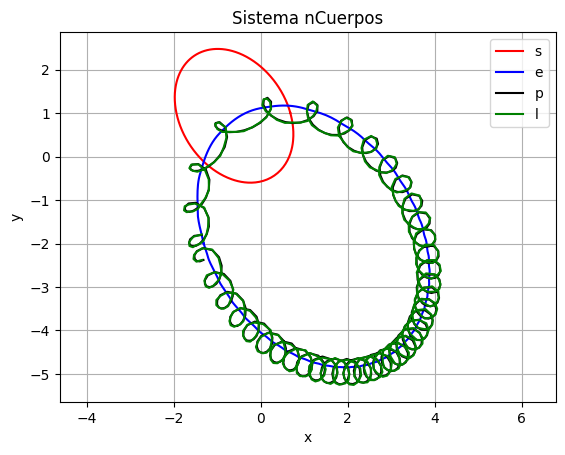

In [ ]:
#Graficamos los valores obtenidos por nCuerpos
plt.plot(rns[0,:,0], rns[0,:,1],'r-', label = 's')
plt.plot(rns[1,:,0], rns[1,:,1],'b-', label = 'e')
plt.plot(rns[2,:,0], rns[2,:,1],'k-', label = 'p')
plt.plot(rns[3,:,0], rns[3,:,1],'g-', label = 'l')
plt.title('Sistema nCuerpos')
plt.legend()
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.grid()

Ahora realicemos una comparación de los gráficos obtenidos mediante estos dos métodos:

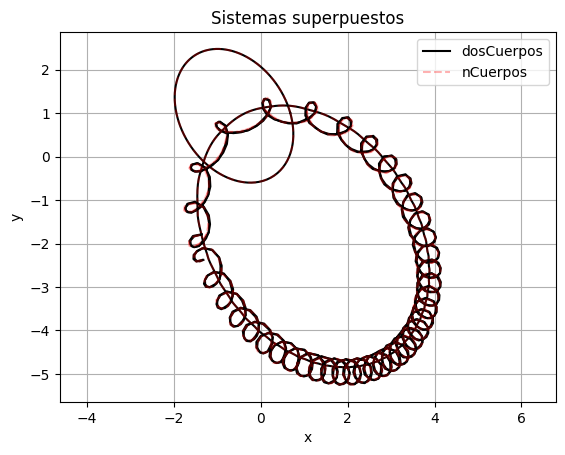

In [ ]:
plt.plot(rs[0,:,0],rs[0,:,1],'k-', label = 'dosCuerpos')
plt.plot(rns[0,:,0],rns[0,:,1],'r--',alpha = 0.3, label = 'nCuerpos')

plt.plot(rs[1,:,0],rs[1,:,1],'k-')
plt.plot(rns[1,:,0],rns[1,:,1],'r--',alpha = 0.3)

plt.plot(rs[2,:,0],rs[2,:,1],'k-')
plt.plot(rns[2,:,0],rns[2,:,1],'r--',alpha = 0.3)

plt.plot(rs[3,:,0],rs[3,:,1],'k-')
plt.plot(rns[3,:,0],rns[3,:,1],'r--',alpha = 0.3)

plt.axis('equal')
plt.title("Sistemas superpuestos")
plt.legend()
plt.xlabel('x')
plt.ylabel('y')
plt.grid()
plt.show()

En principio al obtener los resultados para el sistema por medio de *ncuerpos_solucion*, se puede ver una forma bastante similar a la obtenida con el método *doscuerpos_solucion*. Lo anterior, logra corroborar a la hora de superponer ambos gráficos, lograndose notar una forma bastante identica y mostrando que ambos métodos funcionan correctamente.

# Punto 6

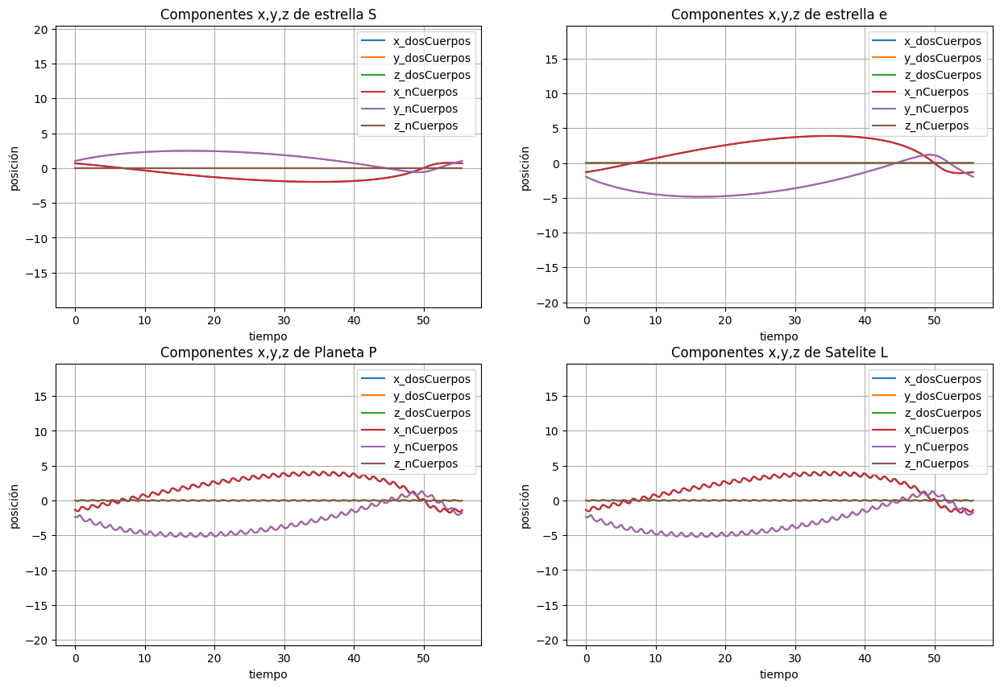

In [ ]:
#Graficos de componentes x,y,z de cada cuerpo con ambos métodos
plt.figure(figsize = (15,10)) #Tamaño para los subplots
plt.subplot(2, 2, 1)
plt.title('Componentes x,y,z de estrella S')
plt.xlabel('tiempo')
plt.ylabel('posición')

plt.plot(ts,rs_s[:,0],label = 'x_dosCuerpos')
plt.plot(ts,rs_s[:,1],label = 'y_dosCuerpos')
plt.plot(ts,rs_s[:,2],label = 'z_dosCuerpos')

plt.plot(ts,rns[0,:,0],label = 'x_nCuerpos')
plt.plot(ts,rns[0,:,1],label = 'y_nCuerpos')
plt.plot(ts,rns[0,:,2],label = 'z_nCuerpos')


plt.axis('equal')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------
plt.subplot(2, 2, 2)
plt.plot(ts,rs_e[:,0],label = 'x_dosCuerpos')
plt.plot(ts,rs_e[:,1],label = 'y_dosCuerpos')
plt.plot(ts,rs_e[:,2],label = 'z_dosCuerpos')

plt.plot(ts,rns[1,:,0],label = 'x_nCuerpos')
plt.plot(ts,rns[1,:,1],label = 'y_nCuerpos')
plt.plot(ts,rns[1,:,2],label = 'z_nCuerpos')

plt.title('Componentes x,y,z de estrella e')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------

plt.subplot(2, 2, 3)
plt.plot(ts,rs_p[:,0],label = 'x_dosCuerpos')
plt.plot(ts,rs_p[:,1],label = 'y_dosCuerpos')
plt.plot(ts,rs_p[:,2],label = 'z_dosCuerpos')

plt.plot(ts,rns[2,:,0],label = 'x_nCuerpos')
plt.plot(ts,rns[2,:,1],label = 'y_nCuerpos')
plt.plot(ts,rns[2,:,2],label = 'z_nCuerpos')

plt.title('Componentes x,y,z de Planeta P')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------

plt.subplot(2, 2, 4)
plt.plot(ts,rs_l[:,0],label = 'x_dosCuerpos')
plt.plot(ts,rs_l[:,1],label = 'y_dosCuerpos')
plt.plot(ts,rs_l[:,2],label = 'z_dosCuerpos')

plt.plot(ts,rns[3,:,0],label = 'x_nCuerpos')
plt.plot(ts,rns[3,:,1],label = 'y_nCuerpos')
plt.plot(ts,rns[3,:,2],label = 'z_nCuerpos')

plt.title('Componentes x,y,z de Satelite L')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()

Al gráficar las componentes del sistema usando cada método, podemos notar nuevamente cómo se acomplan bastante bien, continuando con lo que se había podido analizar anteriormente con el gráfico del sistema completo.
Sin embargo no son exactamente iguales los resultados, por lo cual analizaremos el error entre ellos a continuación.

In [ ]:
Error = np.zeros(4, dtype=list)
for i in range(4):
  Error[i] = rns[i] - rs[i]

pd.DataFrame(np.concatenate((Error[0], Error[1], Error[2], Error[3]), axis = 1),
             columns=["ΔXs", "ΔYs", "ΔZs",
                      "ΔXe", "ΔYe", "ΔZe",
                      "ΔXp", "ΔYp", "ΔZp",
                      "ΔXl", "ΔYl", "ΔZl"])

,ΔXs,ΔYs,ΔZs,ΔXe,ΔYe,ΔZe,ΔXp,ΔYp,ΔZp,ΔXl,ΔYl,ΔZl
0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-1.029519e-07,-5.131067e-08,2.558186e-09,0.000002,0.000001,-2.092078e-09,-0.000237,-0.000148,-0.000007,0.001675,0.000822,0.000069
2,-4.280263e-07,-2.785293e-07,2.007237e-08,0.000006,0.000006,-3.789219e-08,-0.000214,-0.000249,-0.000006,-0.000474,-0.000401,0.000057
3,-8.919073e-07,-7.136575e-07,6.403597e-08,0.000014,0.000016,9.398583e-08,-0.000642,-0.000987,-0.000060,0.000453,0.002541,0.000484
4,-1.403596e-06,-1.324356e-06,1.378622e-07,0.000028,0.000032,1.399173e-06,-0.002053,-0.001553,-0.000116,0.008095,0.001086,0.000322
...,...,...,...,...,...,...,...,...,...,...,...,...
495,-2.150869e-03,4.562886e-03,1.836840e-04,0.005312,-0.009698,6.885206e-05,-0.046430,0.028552,-0.019700,-0.040692,0.000411,-0.021109
496,-2.233117e-03,4.499071e-03,1.908408e-04,0.005101,-0.009659,-1.382252e-04,-0.028107,0.028905,-0.011165,-0.036383,0.041448,-0.010082
497,-2.312526e-03,4.435484e-03,1.979599e-04,0.004862,-0.009420,-3.617813e-04,-0.013469,0.026195,-0.001459,0.016249,0.012419,-0.002481
498,-2.389153e-03,4.372287e-03,2.050204e-04,0.004721,-0.008976,-5.477853e-04,0.001930,0.013105,0.006413,0.009279,-0.015394,0.004744


Notemos cómo con el paso del tiempo, aunque comienza con un error muy bajo, se comienza a propagar hasta tener un error alto en comparación con lo que inicialmente se tenía. Observemos lo anterior gráficamente.

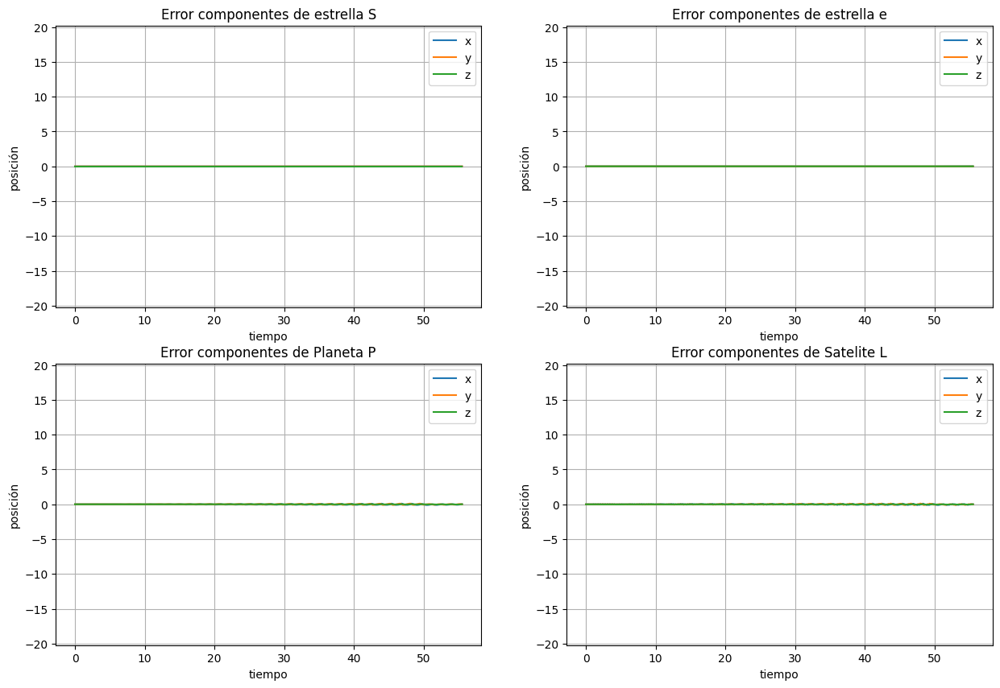

In [ ]:
#Gráficos del error entre los sistemas
plt.figure(figsize = (15,10))
plt.subplot(2, 2, 1)
plt.title('Error componentes de estrella S')
plt.xlabel('tiempo')
plt.ylabel('posición')

plt.plot(ts,Error[0][:,0],label = 'x')
plt.plot(ts,Error[0][:,1],label = 'y')
plt.plot(ts,Error[0][:,2],label = 'z')

plt.axis('equal')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------

plt.subplot(2, 2, 2)
plt.plot(ts,Error[1][:,0],label = 'x')
plt.plot(ts,Error[1][:,1],label = 'y')
plt.plot(ts,Error[1][:,2],label = 'z')

plt.title('Error componentes de estrella e')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------

plt.subplot(2, 2, 3)
plt.plot(ts,Error[2][:,0],label = 'x')
plt.plot(ts,Error[2][:,1],label = 'y')
plt.plot(ts,Error[2][:,2],label = 'z')

plt.title('Error componentes de Planeta P')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()
#-------------------------------------------------------------------------------

plt.subplot(2, 2, 4)
plt.plot(ts,Error[3][:,0],label = 'x')
plt.plot(ts,Error[3][:,1],label = 'y')
plt.plot(ts,Error[3][:,2],label = 'z')

plt.title('Error componentes de Satelite L')
plt.axis('equal')
plt.xlabel('tiempo')
plt.ylabel('posición')
plt.legend()
plt.grid()


Notemos que el error es casi nulo a la hora de ver el gráfico, sin embargo al no usar la función *plt.axis('equal')*,podemos notar lo siguiente:
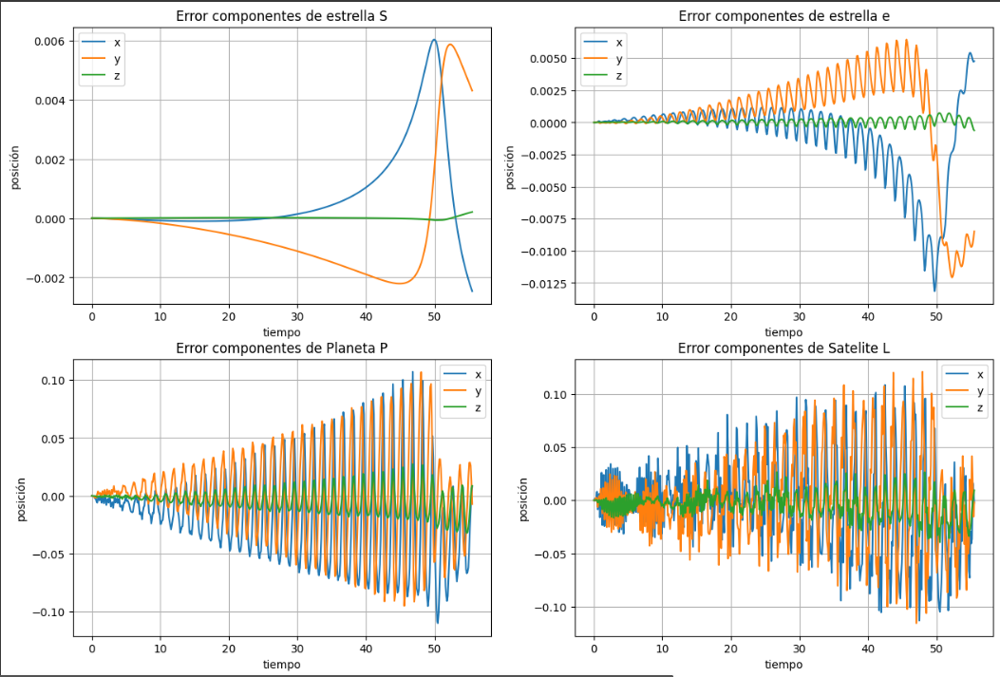


Podemos notar cómo el error crece en el tiempo de la simulación, comenzando de una forma muy baja, hasta el punto de crecer en orden, posiblemente continuando de esta manera mientras más tiempo pase. Esto nos presenta un problema en cuanto a presición se refiere, debido al cambio notorio que presenta el método *doscuerpos_solucion*.

Podemos decir entonces que, el método de dos cuerpos es mucho más apropiado para tiempos de simulación cortos y para la visualización de un sistema jerarquico en cuanto a su comportamiento.

# Punto 7

Para el calculo de las energías usaremos las siguientes ecuaciones propuestas en las diapositivas del curso y nuevamente en el [libro](https://astronomia-udea.co/MecanicaCeleste-Zuluaga/html/06.02.02.00.ProblemaNCuerpos.SolucionAnalitica.Energia.html#ncuerpos_potencial) del profesor Jorge Zuluaga:

$$U = -\frac{1}{2}\sum_{i=1}\sum_{j \neq i} \frac{m_i\mu_j}{r_{ij}}$$

$$K = \frac{1}{2}\sum_i m_i\vec{v}_i^2$$

$$E=K+U$$

Aquí contamos con la energía potencial, cinética y mecánica total para sistema de nCuerpos.

In [ ]:
#Función para calcular la energía cinética
def kinetic(m,v_vec,t):
  k = np.zeros(len(t))
  K = 0
  for i in range(len(t)):
    v = np.linalg.norm(v_vec[i])

    k[i] = 0.5 * m * (v**2)

  return k

#Generamos los valores de la energía cinética para cada cuerpo
ks = kinetic(m_s, vs_s, ts)
ke = kinetic(m_e, vs_e, ts)
kp = kinetic(m_p, vs_p, ts)
kl = kinetic(m_l, vs_l, ts)

#Obtenemos la energía cinética del sistema
kT = ks + ke + kp + kl




In [ ]:

rl = np.array([rs_s, rs_e, rs_p, rs_l]) #definimos una lista con los cuerpos del sistema

M = np.array([m_s, m_e, m_p, m_l]) #definimos una lista con la masa de los cuerpos

#Creamos una función que calcule la energía potencial del sistema
def Potencial(r, m, t):
  U = np.zeros(len(t))

  for i in range(len(t)):
    cont = 0
    for j in range(4):
      if m != M[j] and  np.any(rl[j] != r[i]):
        cont += -0.5 * m * M[j] / np.linalg.norm(r[i] - rl[j,i])
        U[i] = cont
  return U

#Calculamos la energía para cada sistema
Us = Potencial(rl[0],M[0],ts)
Ue = Potencial(rl[1],M[1],ts)
Up = Potencial(rl[2],M[2],ts)
Ul = Potencial(rl[3],M[3],ts)

#Obtenemos la energía potencial total para el sistema
UT = Us+Ue+Up+Ul

E = kT+UT #Obtenemos la energía mecánica del sistema

Ahora, veamos los valores obtenidos para las energías del sistema para el método de *doscuerpos_solución* en unidades canónicas

In [ ]:
pd.DataFrame(list(zip(kT, UT, E)), columns = ["K","U","E"])

,K,U,E
0,0.094271,-0.155825,-0.061554
1,0.092631,-0.154196,-0.061565
2,0.091495,-0.153062,-0.061567
3,0.090798,-0.152359,-0.061561
4,0.091497,-0.153039,-0.061542
...,...,...,...
495,0.104486,-0.166054,-0.061568
496,0.104518,-0.166078,-0.061561
497,0.104290,-0.165846,-0.061556
498,0.106315,-0.167870,-0.061555


Teniendo en cuenta que trabajamos con unidades canónicas en toda la simulación, en principio encontraremos la equivalencia de $U_T$, obteniendo la siguiente expresión:

$$u_T=\sqrt{\frac{u_L^3}{Gu_M}}$$

Teniendo en cuenta que:

$$u_L = 0.01 AU = 1.5 \times 10^9m \hspace{1cm} u_M = 80M_{jup} = 151.84 \times 10^{27} kg  $$
$$G=6.67×10^{11} m^3 kg^{-1}s^{-2}$$

Obtenemos así un valor equivalente a  $u_T\simeq 5.071 h$, de esta forma podemos realizar la conversión necesaria para expresar los valores.

In [ ]:
#Realicemos el cambio de unidades canónicas a convencionales
G = 6.67e-11
u_m = 80 * 1.898e27
u_l = 1.5e9
u_t = (np.sqrt((u_l)**3/(u_m * G)))/3600

tD = np.linspace(0,55.5*u_t/24,500) #Conversion del tiempo de simulación

J = ((u_m*(u_l)**2)/(u_t*3600)**2)

Con el fin de comparar de la misma manera la energía del sistema de ncuerpossolución, calcularemos los valores y realizaremos las conversiones necesarias.

In [ ]:
#Llamamos las cuadraturas que nos proporciona la función ncuerpos_solucion
Kn = cuadraturas["K"]
Un = cuadraturas["U"]
En = Kn + Un

Obsevemos lo valores obtenidos por el método de *n cuerpos solución*

In [ ]:
pd.DataFrame(list(zip(Kn, Un, En)), columns = ["K","U","E"])

,K,U,E
0,0.094271,-0.155825,-0.061554
1,0.092647,-0.154201,-0.061554
2,0.091487,-0.153041,-0.061554
3,0.090777,-0.152331,-0.061554
4,0.091468,-0.153022,-0.061554
...,...,...,...
495,0.103905,-0.165458,-0.061554
496,0.103452,-0.165006,-0.061554
497,0.103257,-0.164810,-0.061554
498,0.105075,-0.166629,-0.061554


In [ ]:
#Calculamos los errores entre ambos métodos
ErrorK = Kn - kT
ErrorU = Un - UT
ErrorE = En - E

Ahora realizaremos las conversiones necesarias, para posteriormente dar cuenta del error entre los dos métodos de solución

Text(0, 0.5, 'E(J)')

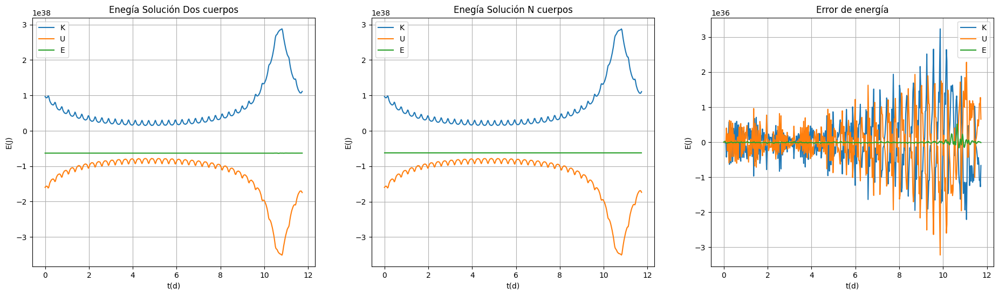

In [ ]:
#Graficamos la energía del sistema
plt.figure(figsize=(23,6))
plt.subplot(1,3,1)

plt.plot(tD, kT*J, label = 'K')
plt.plot(tD, UT*J, label = 'U')
plt.plot(tD, E*J, label = 'E')

plt.legend()
plt.title("Enegía Solución Dos cuerpos")
plt.grid()
plt.xlabel("t(d)")
plt.ylabel("E(J)")
#-------------------------------------------------------------------------------
plt.subplot(1,3,2)

plt.plot(tD, Kn*J, label = 'K')
plt.plot(tD, Un*J, label = 'U')
plt.plot(tD, En*J, label = 'E')

plt.legend()
plt.grid()
plt.title("Enegía Solución N cuerpos")
plt.xlabel("t(d)")
plt.ylabel("E(J)")
#-------------------------------------------------------------------------------
plt.subplot(1,3,3)

plt.plot(tD, ErrorK*J, label = 'K')
plt.plot(tD, ErrorU*J, label = 'U')
plt.plot(tD, ErrorE*J, label = 'E')

plt.legend()
plt.grid()
plt.title("Error de energía")
plt.xlabel("t(d)")
plt.ylabel("E(J)")



Ahora, visualicemos los valores obtenidos para los errores del sistema

In [ ]:
pd.DataFrame(list(zip(ErrorK, ErrorU, ErrorE)), columns = ["Error K","Error U","Error E"])

,Error K,Error U,Error E
0,0.000000,-2.775558e-17,-2.775558e-17
1,0.000015,-4.438185e-06,1.092745e-05
2,-0.000008,2.084451e-05,1.312979e-05
3,-0.000021,2.810377e-05,6.924043e-06
4,-0.000029,1.678961e-05,-1.222133e-05
...,...,...,...
495,-0.000581,5.950702e-04,1.384607e-05
496,-0.001066,1.072407e-03,6.564065e-06
497,-0.001034,1.035467e-03,1.900250e-06
498,-0.001240,1.241575e-03,1.304581e-06


Podemos identificar que ambos métodos cumplen con el comportamiento de la energía esperado para este sistema, cumpliendo el *teorema del virial*, donde obtenemos para el valor de E una constante.

De la misma manera que en la explicación anterior, evidenciamos una propagación de error que crece con el tiempo, mostrandonos nuevamente que el método de *doscuerpos_solución* cuenta con este detalle incluso en su solución energética. Sin embargo las aproximaciones obtenidas logran el comportamiento esperado y con ello, otorgan una simulación util a la hora de estudiar este tipo de sistemas.